# [AICE Professional 문제풀이 특강] (Text) 네이버 영화 리뷰 감성분류
+ 본과정에서는 네이버 영화 리뷰 데이터를 가지고 텍스트 언어 모델을 만들고
 감성분류 실습하겠습니다.
+ 첫번째는 네이버 영화 리뷰 데이터를 전처리하고, TF-IDF 토큰나이져를 활용하여 토큰화하고 머신러닝으로 모델링 만들고 감성분류 수행합니다.
+ 두번째는 keras 토큰나이져를 활용하여 토큰화하고 일정 크기의 문장으로 맞추기 위해 패딩 및 embedding 레이어를 이용해서 단어를 n차원 밀집벡터를 만들고 train시에 학습되도록 합니다.그리고 나서 LSTM 모델을 이용하여 감성분류를 수행합니다.
+ KoBert 활용하여 감정말뭉치 데이터 감성 분류 수행합니다.

### 참고 사이트
- 네이버 영화 리뷰 감성 분류하기 : https://wikidocs.net/106446
- BERT를 활용한 네이버 영화 리뷰 감정 분류 : https://velog.io/@fragrance_0/NLP-BERT-%EC%8B%A4%EC%8A%B5-%EC%98%88%EC%A0%9C-%EB%84%A4%EC%9D%B4%EB%B2%84-%EC%98%81%ED%99%94-%EB%A6%AC%EB%B7%B0-%EA%B0%90%EC%A0%95-%EB%B6%84%EB%A5%98
- 딥 러닝을 이용한 자연어 처리 입문 : https://wikidocs.net/book/2155
- 딥 러닝을 이용한 자연어 처리 입문(github) :https://github.com/ukairia777/tensorflow-nlp-tutorial

<br>
<br>

<br>
<br>
<br>

#   
# A. 머신러닝 이용하여 자연어 Classification하기
+ 네이버 영화 리뷰 데이터를 가지고
+ RandomForest/SGD 모델 학습하여 감정 Classification 모델링해 보겠습니다.

<br>
<br>
<br>

## 0. COLAB 한글 깨짐

In [ ]:
# 1. 실행
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  fonts-nanum
0 upgraded, 1 newly installed, 0 to remove and 49 not upgraded.
Need to get 10.3 MB of archives.
After this operation, 34.1 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 fonts-nanum all 20200506-1 [10.3 MB]
Fetched 10.3 MB in 2s (4,696 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 78, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package fonts-nanum.
(Reading database ... 123597 files and dire

####  **코랩(Colab)의 런타임을 재시작 합니다.**

<br>
<br>

#   
## 1. 라이브러리 임포트

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import urllib.request
plt.rc('font', family='NanumBarunGothic')

#   
## 2. 파일 읽어오기

In [ ]:
# 네이버 영화 리뷰 데이터 읽어오기
# urllib.request.urlretrieve("https://raw.githubusercontent.com/e9t/nsmc/master/ratings_train.txt", filename="ratings_train.txt")
# urllib.request.urlretrieve("https://raw.githubusercontent.com/e9t/nsmc/master/ratings_test.txt", filename="ratings_test.txt")

!git clone https://github.com/e9t/nsmc.git

Cloning into 'nsmc'...
remote: Enumerating objects: 14763, done.
remote: Counting objects: 100% (14762/14762), done.
remote: Compressing objects: 100% (13012/13012), done.
remote: Total 14763 (delta 1748), reused 14762 (delta 1748), pack-reused 1 (from 1)
Receiving objects: 100% (14763/14763), 56.19 MiB | 10.42 MiB/s, done.
Resolving deltas: 100% (1748/1748), done.
Updating files: 100% (14737/14737), done.


In [ ]:
# 데이터 확인하기
final_data = pd.read_csv("./nsmc/ratings.txt", delimiter='\t', quoting=3)

In [ ]:
final_data.head(3)

,id,document,label
0,8112052,어릴때보고 지금다시봐도 재밌어요ㅋㅋ,1
1,8132799,"디자인을 배우는 학생으로, 외국디자이너와 그들이 일군 전통을 통해 발전해가는 문화산...",1
2,4655635,폴리스스토리 시리즈는 1부터 뉴까지 버릴께 하나도 없음.. 최고.,1


In [ ]:
# 총 200000 건
final_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   id        200000 non-null  int64 
 1   document  199992 non-null  object
 2   label     200000 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 4.6+ MB


#   
## 3. 전처리 : Null, 중복 제거

In [ ]:
# final_data 어떤 컬럼과 내용으로 되어 있는지 다시 확인
final_data.tail()

,id,document,label
199995,8963373,포켓 몬스터 짜가 ㅡㅡ;;,0
199996,3302770,쓰.레.기,0
199997,5458175,완전 사이코영화. 마지막은 더욱더 이 영화의질을 떨어트린다.,0
199998,6908648,왜난 재미없었지 ㅠㅠ 라따뚜이 보고나서 스머프 봐서 그런가 ㅋㅋ,0
199999,8548411,포풍저그가나가신다영차영차영차,0


In [ ]:
# '문장' 컬럼의 내용을 양끝의 빈공간 삭제
final_data['document'] = final_data['document'].str.strip()

In [ ]:
# Null 있는지 확인 : 없음
final_data.isnull().sum()

,0
id,0
document,8
label,0


In [ ]:
# null 데이터 삭제
final_data.dropna(inplace=True)

In [ ]:
# 중복 데이터 있는지 확인 : 중복 존재 확인
final_data['document'].duplicated().sum()

5449

In [ ]:
# 중복 데이터 제거
final_data.drop_duplicates(subset=['document'], inplace=True)

In [ ]:
# info 정보 확인
final_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 194543 entries, 0 to 199999
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   id        194543 non-null  int64 
 1   document  194543 non-null  object
 2   label     194543 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 5.9+ MB


#   
## 4. 영문, 숫자, 특수문자 제거

In [ ]:
# '문장' 컬럼의 내용중에 영문, 특수문자 있는지 확인 : 영문과 특수문자 존재 확인
final_data[ final_data['document'].str.contains('[^가-힣 ]') ].head(3)

,id,document,label
0,8112052,어릴때보고 지금다시봐도 재밌어요ㅋㅋ,1
1,8132799,"디자인을 배우는 학생으로, 외국디자이너와 그들이 일군 전통을 통해 발전해가는 문화산...",1
2,4655635,폴리스스토리 시리즈는 1부터 뉴까지 버릴께 하나도 없음.. 최고.,1


In [ ]:
# '문장' 컬럼의 내용에서 숫자, 영문자, 특수문자등의 글자는 삭제처리
# final_data['문장'].replace('[^가-힣 ]','', regex=True) : 이렇게도 가능

final_data['document'] = final_data['document'].str.replace('[^가-힣 ]','', regex=True)

In [ ]:
# '문장' 컬럼의 내용에서 영문, 특수문자 없음 확인
final_data['document'][final_data['document'].str.contains('[^가-힣 ]')].sum()

0

In [ ]:
# 숫자, 영문자, 특수문자 등 제거후 데이터 확인하기.
final_data.head(3)

,id,document,label
0,8112052,어릴때보고 지금다시봐도 재밌어요,1
1,8132799,디자인을 배우는 학생으로 외국디자이너와 그들이 일군 전통을 통해 발전해가는 문화산업...,1
2,4655635,폴리스스토리 시리즈는 부터 뉴까지 버릴께 하나도 없음 최고,1


## 5. Label 분포 확인

In [ ]:
# label '감정' 분포 확인 : 총 6개이며, 고루게 분포 확인. 단 기쁨이 약간 부족해 보임
final_data['label'].value_counts()

,count
label,
0,97277
1,97266


#    
## 6. X, Y 분리

In [ ]:
# X, Y 분리

features = final_data['document']
labels = final_data['label']

In [ ]:
features.shape, labels.shape

((194543,), (194543,))

In [ ]:
# features 내용 3개 출력
features.head(3), labels.head(3)

(0                                    어릴때보고 지금다시봐도 재밌어요
 1    디자인을 배우는 학생으로 외국디자이너와 그들이 일군 전통을 통해 발전해가는 문화산업...
 2                     폴리스스토리 시리즈는 부터 뉴까지 버릴께 하나도 없음 최고
 Name: document, dtype: object,
 0    1
 1    1
 2    1
 Name: label, dtype: int64)

In [ ]:
print('이벤트 문자열 최대 길이 :{}'.format(max(len(l) for l in features)))
print('이벤트 문자열 평균 길이 :{}'.format(sum(map(len, features))/len(features)))

이벤트 문자열 최대 길이 :140
이벤트 문자열 평균 길이 :32.56406038767779


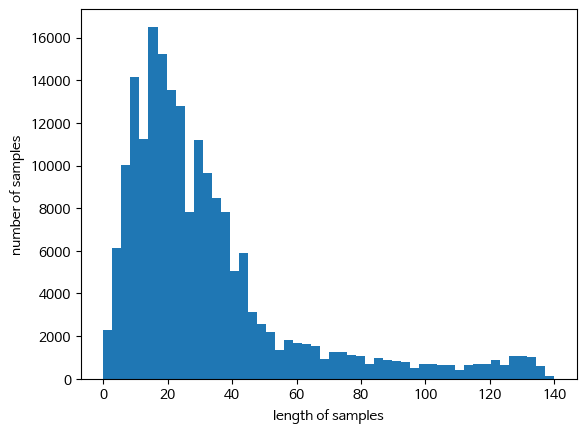

In [ ]:
# 히스토그램을 보면 30~40 부근에 많이 몰려 있음 알수 있다.
plt.hist([len(s) for s in features], bins=50)
plt.xlabel('length of samples')
plt.ylabel('number of samples')
plt.show()

#   
## 7. train set와 test set 분리

In [ ]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(features, labels , test_size=0.2, random_state=41)
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((155634,), (38909,), (155634,), (38909,))

#   
## 7. TF-IDF 변환하기

In [ ]:
# 말뭉치를 TF-IDF로 변환하기

from sklearn.feature_extraction.text import TfidfVectorizer

tfidf = TfidfVectorizer()
x_train_v = tfidf.fit_transform( x_train )
x_test_v = tfidf.transform( x_test )

y_train_v = y_train.copy()
y_test_v = y_test.copy()

In [ ]:
# 각 라인의 각 단어에 대한 TF-IDF 값 표현
print(x_train_v[:3])

  (0, 222067)	0.43755796573599365
  (0, 289279)	0.43755796573599365
  (0, 252738)	0.43755796573599365
  (0, 261178)	0.2825548820326435
  (0, 97190)	0.39285473794194586
  (0, 35712)	0.43755796573599365
  (1, 259947)	0.3507183876719442
  (1, 213147)	0.25172133303393845
  (1, 86742)	0.39312089653684307
  (1, 243996)	0.41082045764949277
  (1, 166592)	0.35505515660971493
  (1, 63921)	0.3169894166825869
  (1, 253387)	0.32107047280162876
  (1, 26564)	0.40085258175314464
  (2, 127871)	0.6117362759984013
  (2, 89731)	0.43192332579843074
  (2, 34199)	0.6627374814048397


In [ ]:
# 학습데이터셋의 TF-IDF 매트릭스 확인하기 : 41259 라인, 47366 단어
x_train_v.shape

(155634, 306861)

In [ ]:
print(x_test_v[:1])

  (0, 296883)	0.34090191313090173
  (0, 188060)	0.1877710486666569
  (0, 155269)	0.24729163136606458
  (0, 122155)	0.3577255327170684
  (0, 113329)	0.4469586451306702
  (0, 79316)	0.3773767865467078
  (0, 64486)	0.4622434039643917
  (0, 37669)	0.3217964841556908


#   
## 8. 머신러닝 모델링

In [ ]:
# 전체 데이터로 학습하는 1분 내외 소요 : 성능 76% 나옴, 성능 잘 나옴.

from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import SGDClassifier
import time

start = time.time()

# rfc = RandomForestClassifier()
# rfc.fit(x_train_v, y_train_v)
# print(f'RandomForestClassifier 성능 : { rfc.score(x_test_v, y_test_v) }')

sgdc = SGDClassifier()
sgdc.fit(x_train_v, y_train_v)
print(f'SGDClassifier 성능 : { sgdc.score(x_test_v, y_test_v) }')

end = time.time()
print(f'총학습시간: { end - start }')

SGDClassifier 성능 : 0.7655555269988948
총학습시간: 0.28365373611450195


### 10. 예측해 보기

In [ ]:
# 출력 결과 해석 : (0, 44327)	0.241660101642553
# 0 : 첫라인, 44327 : 단어에 맵핑된 번호, 0.241660101642553 : tf-idf 계산 값

print(f'검증데이터셋의 첫번째 TF-IDF : {x_test_v[:1]}')

검증데이터셋의 첫번째 TF-IDF :   (0, 296883)	0.34090191313090173
  (0, 188060)	0.1877710486666569
  (0, 155269)	0.24729163136606458
  (0, 122155)	0.3577255327170684
  (0, 113329)	0.4469586451306702
  (0, 79316)	0.3773767865467078
  (0, 64486)	0.4622434039643917
  (0, 37669)	0.3217964841556908


In [ ]:
print(f'검증데이터셋의 첫번째 TF-IDF 역변환 : {tfidf.inverse_transform(x_test_v[:1])}')

검증데이터셋의 첫번째 TF-IDF 역변환 : [array(['허나', '영화를', '싶다', '불쌍', '보기전으로', '마지막에는', '돌이키고', '나에겐'],
      dtype='<U139')]


In [ ]:
# RandomForest 모델로 예측하기
predict = sgdc.predict(x_test_v[:1])
print(predict)

[1]


<br>
<br>
<br>
<br>

# 배운 내용 정리
1. 네이버 영화 리뷰 데이터 읽어오고
2. 데이터 전처리 : 한글, 공백외의 영어, 숫자, 특수문자등 제거
3. 19만개의 전체 데이터 가지고 진행!!
3. TF-IDF 토큰나이져 활용하여 토큰화하고 문장을 숫자로 나열
4. 머신러닝 모델을 활용하여 감성분류 수행
5. 때로는 ,  많은 텍스트 데이터로 머신러닝 실행하기 쉽지 않다.(메모리 부족, 시간 오래 걸림)
9. 추가로 고민할 사항입니다.
  - 검증셋 성능이 높다고 채점 점수가 잘 나올까?
  - TF-IDF 토큰나이져 대신, CountVectorizer 사용하면?
  - SGD 모델대신 RandomForest, LogisticRegression등을 사용하면?


<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>

# B. Keras Tokenizing + LTSM 모델 이용하여 Classification하기
+ 네이버 영화 리뷰 데이터를 가지고
+ 전체 문장에 대해 Keras Tokenizing
+ LSTM 모델학습하여 감정 분류 보겠습니다.

<br>
<br>

#   
## 1. 라이브러리 임포트

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import urllib.request

#   
## 2. 파일 읽어오기

In [ ]:
# 네이버 영화 리뷰 데이터 읽어오기
# urllib.request.urlretrieve("https://raw.githubusercontent.com/e9t/nsmc/master/ratings_train.txt", filename="ratings_train.txt")
# urllib.request.urlretrieve("https://raw.githubusercontent.com/e9t/nsmc/master/ratings_test.txt", filename="ratings_test.txt")

!git clone https://github.com/e9t/nsmc.git

fatal: destination path 'nsmc' already exists and is not an empty directory.


In [ ]:
# 데이터 확인하기
final_data = pd.read_csv("./nsmc/ratings.txt", delimiter='\t', quoting=3)

In [ ]:
final_data.head(3)

,id,document,label
0,8112052,어릴때보고 지금다시봐도 재밌어요ㅋㅋ,1
1,8132799,"디자인을 배우는 학생으로, 외국디자이너와 그들이 일군 전통을 통해 발전해가는 문화산...",1
2,4655635,폴리스스토리 시리즈는 1부터 뉴까지 버릴께 하나도 없음.. 최고.,1


In [ ]:
# 총 200000 건
final_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   id        200000 non-null  int64 
 1   document  199992 non-null  object
 2   label     200000 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 4.6+ MB


#   
## 3. 전처리 : Null, 중복 제거

In [ ]:
# final_data 어떤 컬럼과 내용으로 되어 있는지 다시 확인
final_data.tail()

,id,document,label
199995,8963373,포켓 몬스터 짜가 ㅡㅡ;;,0
199996,3302770,쓰.레.기,0
199997,5458175,완전 사이코영화. 마지막은 더욱더 이 영화의질을 떨어트린다.,0
199998,6908648,왜난 재미없었지 ㅠㅠ 라따뚜이 보고나서 스머프 봐서 그런가 ㅋㅋ,0
199999,8548411,포풍저그가나가신다영차영차영차,0


In [ ]:
# '문장' 컬럼의 내용을 양끝의 빈공간 삭제
final_data['document'] = final_data['document'].str.strip()

In [ ]:
# Null 있는지 확인 : 없음
final_data.isnull().sum()

,0
id,0
document,8
label,0


In [ ]:
# null 데이터 삭제
final_data.dropna(inplace=True)

In [ ]:
# 중복 데이터 있는지 확인 : 중복 존재 확인
final_data['document'].duplicated().sum()

5449

In [ ]:
# 중복 데이터 제거
final_data.drop_duplicates(subset=['document'], inplace=True)

In [ ]:
# info 정보 확인
final_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 194543 entries, 0 to 199999
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   id        194543 non-null  int64 
 1   document  194543 non-null  object
 2   label     194543 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 5.9+ MB


#   
## 4. 영문, 숫자, 특수문자 제거

In [ ]:
# '문장' 컬럼의 내용중에 영문, 특수문자 있는지 확인 : 영문과 특수문자 존재 확인
final_data[ final_data['document'].str.contains('[^가-힣 ]') ].head(3)

,id,document,label
0,8112052,어릴때보고 지금다시봐도 재밌어요ㅋㅋ,1
1,8132799,"디자인을 배우는 학생으로, 외국디자이너와 그들이 일군 전통을 통해 발전해가는 문화산...",1
2,4655635,폴리스스토리 시리즈는 1부터 뉴까지 버릴께 하나도 없음.. 최고.,1


In [ ]:
# '문장' 컬럼의 내용에서 숫자, 영문자, 특수문자등의 글자는 삭제처리
# final_data['문장'].replace('[^가-힣 ]','', regex=True) : 이렇게도 가능

final_data['document'] = final_data['document'].str.replace('[^가-힣 ]','', regex=True)

In [ ]:
# '문장' 컬럼의 내용에서 영문, 특수문자 없음 확인
final_data['document'][final_data['document'].str.contains('[^가-힣 ]')].sum()

0

In [ ]:
# 숫자, 영문자, 특수문자 등 제거후 데이터 확인하기.
final_data.head(3)

,id,document,label
0,8112052,어릴때보고 지금다시봐도 재밌어요,1
1,8132799,디자인을 배우는 학생으로 외국디자이너와 그들이 일군 전통을 통해 발전해가는 문화산업...,1
2,4655635,폴리스스토리 시리즈는 부터 뉴까지 버릴께 하나도 없음 최고,1


#   
## 5. Label 분포 확인

In [ ]:
# label '감정' 분포 확인 : 총 6개이며, 고루게 분포 확인. 단 기쁨이 약간 부족해 보임
final_data['label'].value_counts()

,count
label,
0,97277
1,97266


#   
## 6. X, Y 분리

In [ ]:
# X, Y 분리
features = final_data['document'].values
labels = final_data['label'].values

In [ ]:
features.shape, labels.shape

((194543,), (194543,))

In [ ]:
# features 내용 3개 출력
features[:3]

array(['어릴때보고 지금다시봐도 재밌어요',
       '디자인을 배우는 학생으로 외국디자이너와 그들이 일군 전통을 통해 발전해가는 문화산업이 부러웠는데 사실 우리나라에서도 그 어려운시절에 끝까지 열정을 지킨 노라노 같은 전통이있어 저와 같은 사람들이 꿈을 꾸고 이뤄나갈 수 있다는 것에 감사합니다',
       '폴리스스토리 시리즈는 부터 뉴까지 버릴께 하나도 없음 최고'], dtype=object)

In [ ]:
print('이벤트 문자열 최대 길이 :{}'.format(max(len(l) for l in features)))
print('이벤트 문자열 평균 길이 :{}'.format(sum(map(len, features))/len(features)))

이벤트 문자열 최대 길이 :140
이벤트 문자열 평균 길이 :32.56406038767779


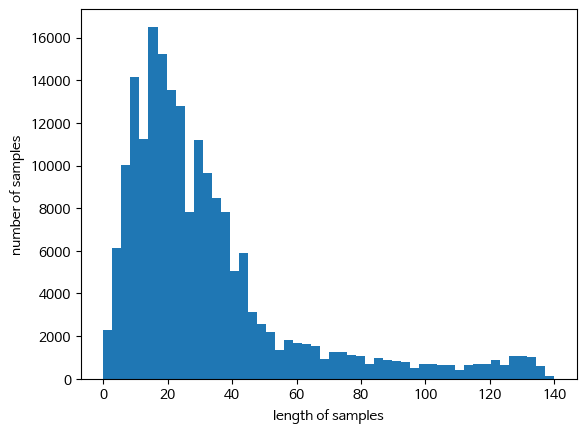

In [ ]:
# 히스토그램을 보면 30~40 부근에 많이 몰려 있음 알수 있다.
plt.hist([len(s) for s in features], bins=50)
plt.xlabel('length of samples')
plt.ylabel('number of samples')
plt.show()

#   
## 7. train set와 test set 분리

In [ ]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(features, labels , test_size=0.2, stratify=labels, random_state=41)
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((155634,), (38909,), (155634,), (38909,))

In [ ]:
# 샘플확인 , 라벨 확인
# {0: '불안', 1: '분노', 2: '상처', 3: '슬픔', 4: '당황', 5: '기쁨'}

x_train[:2], y_train[:2]

(array(['사슴벌레 꼭 죽여야만 했는가 생명존중사상이 없군', '어린시절 넘 재미있게 봤네요 상도의 카리스마 쩔죠 '],
       dtype=object),
 array([0, 1]))

#   
## 8. 전체 문장에 대해 Tokenizing
+ 컴퓨터가 이해하기 위해 모든 단어를 숫자로 변환해야 함.
+ 단어 빈도수 따지지 않고 무조건 모든 단어 수용해서 진행

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

In [ ]:
# Tokenizer 구현 : 단어 사전 만들기(fit_on_texts)
tokenizer = Tokenizer()
tokenizer.fit_on_texts(x_train)

In [ ]:
# 단어에 대한 숫자 매핑
print(tokenizer.word_index)

{'영화': 1, '너무': 2, '정말': 3, '진짜': 4, '이': 5, '왜': 6, '그냥': 7, '이런': 8, '더': 9, '수': 10, '영화를': 11, '점': 12, '잘': 13, '다': 14, '보고': 15, '좀': 16, '영화는': 17, '그': 18, '영화가': 19, '본': 20, '봤는데': 21, '최고의': 22, '내가': 23, '없는': 24, '이건': 25, '없다': 26, '드라마': 27, '이렇게': 28, '평점': 29, '이거': 30, '완전': 31, '이게': 32, '참': 33, '있는': 34, '아': 35, '좋은': 36, '평점이': 37, '보는': 38, '연기': 39, '그리고': 40, '다시': 41, '내': 42, '역시': 43, '것': 44, '많이': 45, '난': 46, '한': 47, '쓰레기': 48, '스토리': 49, '재밌게': 50, '최고': 51, '없고': 52, '하는': 53, '또': 54, '보면': 55, '꼭': 56, '가장': 57, '마지막': 58, '영화다': 59, '무슨': 60, '뭐': 61, '아깝다': 62, '같은': 63, '하지만': 64, '볼': 65, '만든': 66, '안': 67, '작품': 68, '대한': 69, '솔직히': 70, '끝까지': 71, '봐도': 72, '넘': 73, '말이': 74, '전혀': 75, '지금': 76, '영화의': 77, '별로': 78, '내내': 79, '같다': 80, '시간': 81, '아주': 82, '할': 83, '다른': 84, '그래도': 85, '최악의': 86, '와': 87, '좋다': 88, '있다': 89, '어떻게': 90, '하고': 91, '재미': 92, '하나': 93, '뭔가': 94, '많은': 95, '중': 96, '않고': 97, '연기가': 98, '듯': 99, '모두': 100, '별': 101, 

In [ ]:
# 반대로 숫자로 단어 매핑
print(tokenizer.index_word)

{1: '영화', 2: '너무', 3: '정말', 4: '진짜', 5: '이', 6: '왜', 7: '그냥', 8: '이런', 9: '더', 10: '수', 11: '영화를', 12: '점', 13: '잘', 14: '다', 15: '보고', 16: '좀', 17: '영화는', 18: '그', 19: '영화가', 20: '본', 21: '봤는데', 22: '최고의', 23: '내가', 24: '없는', 25: '이건', 26: '없다', 27: '드라마', 28: '이렇게', 29: '평점', 30: '이거', 31: '완전', 32: '이게', 33: '참', 34: '있는', 35: '아', 36: '좋은', 37: '평점이', 38: '보는', 39: '연기', 40: '그리고', 41: '다시', 42: '내', 43: '역시', 44: '것', 45: '많이', 46: '난', 47: '한', 48: '쓰레기', 49: '스토리', 50: '재밌게', 51: '최고', 52: '없고', 53: '하는', 54: '또', 55: '보면', 56: '꼭', 57: '가장', 58: '마지막', 59: '영화다', 60: '무슨', 61: '뭐', 62: '아깝다', 63: '같은', 64: '하지만', 65: '볼', 66: '만든', 67: '안', 68: '작품', 69: '대한', 70: '솔직히', 71: '끝까지', 72: '봐도', 73: '넘', 74: '말이', 75: '전혀', 76: '지금', 77: '영화의', 78: '별로', 79: '내내', 80: '같다', 81: '시간', 82: '아주', 83: '할', 84: '다른', 85: '그래도', 86: '최악의', 87: '와', 88: '좋다', 89: '있다', 90: '어떻게', 91: '하고', 92: '재미', 93: '하나', 94: '뭔가', 95: '많은', 96: '중', 97: '않고', 98: '연기가', 99: '듯', 100: '모두', 101: '별', 

In [ ]:
# 단어별 빈도수 확인
print(tokenizer.word_counts)

OrderedDict([('사슴벌레', 1), ('꼭', 1280), ('죽여야만', 2), ('했는가', 13), ('생명존중사상이', 1), ('없군', 38), ('어린시절', 59), ('넘', 951), ('재미있게', 761), ('봤네요', 220), ('상도의', 1), ('카리스마', 53), ('쩔죠', 3), ('년대', 484), ('영화인가요', 18), ('허접해', 8), ('쓰레기같은', 95), ('영화인들에', 1), ('대한이야기는', 1), ('언급되지', 1), ('않은', 642), ('모순투성이영화', 1), ('영화판에', 7), ('대한', 1002), ('실상을', 15), ('파헤친다는', 1), ('소린', 3), ('뭐지', 290), ('그렇게', 494), ('영화를', 3104), ('보고도', 45), ('연기', 1709), ('디렉팅에는', 1), ('관대하다니', 1), ('견자는', 1), ('검술', 6), ('실력을', 5), ('숨기고', 8), ('있었나', 25), ('참', 1830), ('몇일', 7), ('사이', 30), ('일류', 7), ('고수가', 5), ('되다니', 23), ('백지는', 1), ('뭐냐', 263), ('왜', 3571), ('사랑한다고', 10), ('따라', 77), ('다니겨', 1), ('멍청하고', 16), ('한심스러운', 7), ('캐릭터만', 7), ('나와', 120), ('정말', 8574), ('집에서봐서그런지', 1), ('비주얼덕에', 1), ('끝까지보는데', 5), ('나름지루하지않았다', 1), ('미국판화산고라지고하는데', 1), ('솔까', 30), ('화산고', 4), ('보단', 71), ('잘만들어진영화같았음', 1), ('다른사람들', 5), ('머라해도', 2), ('저는', 282), ('막장드라마', 37), ('좋아합니다', 30), ('하도', 59), ('마니바서그런지이게', 1), ('개막장인지도모르

In [ ]:
# 총 단어 갯수 : 47,646
max_words = len(tokenizer.index_word)
print(max_words)

308560


#   
## 9. texts_to_sequences : 문장을 숫자로 나열
- 빈도수 적은 단어 제외하는것 없이 모든 단어 포함해서 진행
- 그리고, 예를 들어 1번 등장하는 단어는 삭제하는 작업은 필요시 수행!!

In [ ]:
# 문장을 숫자로 나열
x_train_seq = tokenizer.texts_to_sequences(x_train)
x_test_seq = tokenizer.texts_to_sequences(x_test)

In [ ]:
# 문장을 숫자로 변경후 갯수 확인
# x_train.shape, x_test.shape, y_train.shape, y_test.shape : ((41259,), (10315,), (41259,), (10315,))
print(len(x_train_seq), len(x_test_seq))

155634 38909


In [ ]:
print(x_train[1:3])
print(x_train_seq[1:3])

['어린시절 넘 재미있게 봤네요 상도의 카리스마 쩔죠 ' '년대 영화인가요 넘 허접해']
[[2123, 73, 104, 510, 70619, 2370, 31042], [209, 6593, 73, 13637]]


#   
## 10. Padding Sequence

In [ ]:
# 문장의 최대 길이 파악 : 제일 긴 문장 seq 길이는 38개로 구성됨.
max(len(line) for line in x_train_seq)

42

In [ ]:
# 모든 문장을 최대 문장 Seq 길이 42에 맞춘다.
x_train_pad = pad_sequences(x_train_seq, maxlen=42)
x_test_pad = pad_sequences(x_test_seq, maxlen=42)

In [ ]:
# 문장 Seq 내용을 보니 잘 패딩되어 있음 확인
x_train_pad[:1]

array([[    0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
        70617,    56, 42443,  8856, 70618,  3253]], dtype=int32)

In [ ]:
# 문장 Seq 패딩의 shape 확인
x_train_pad.shape, x_test_pad.shape

((155634, 42), (38909, 42))

#   
## 11. LSTM 모델링

In [ ]:
from tensorflow.keras.layers import Dense, Flatten, Conv1D, MaxPool2D
from tensorflow.keras.layers import Embedding, Bidirectional, LSTM, SimpleRNN, GRU
from tensorflow.keras.models import Sequential
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

In [ ]:
# 하이퍼 파라미터

max_words = 47646 + 1    # 총 단어 갯수 + padding 0 번호
max_len = 42             # 최대 문장 길이
embedding_dim = 64      # embedding 차원

In [ ]:
# 모델 선언
model = Sequential()

In [ ]:
# 단어를 의미있는 64 차원으로 Vector 변경(Embedding)
model.add(Embedding(max_words, embedding_dim, input_length=max_len))

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/embedding.py:90: UserWarning: Argument `input_length` is deprecated. Just remove it.
  warnings.warn(


In [ ]:
# LSTM 모델
model.add(LSTM(16, return_sequences=True))
model.add(LSTM(16, return_sequences=True))
model.add(Flatten())
model.add(Dense(128, activation='swish'))
model.add(Dense(32, activation='swish'))
model.add(Dense(2, activation='softmax'))

model.compile(loss = 'sparse_categorical_crossentropy',
              optimizer = 'adam',
              metrics = ['accuracy'])
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding (Embedding)                │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm (LSTM)                          │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ ?                           │     0 (unbuilt) │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 0 (0.00 B)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# 조기종료 콜백함수 정의(EarlyStopping)
es = EarlyStopping(monitor='val_loss', patience=10, verbose=1)

# 체크포인트 저장(EarlyStopping)
checkpoint_path = 'tmp_checkpoint.keras'
cp = ModelCheckpoint(checkpoint_path, monitor='val_loss', verbose=1, save_best_only=True)

In [ ]:
# 모델 학습(fit) : 77% 성능 보임
history = model.fit(x_train_pad, y_train, epochs=50, batch_size=512,
                      validation_data=(x_test_pad, y_test), verbose =1, callbacks=[es, cp])

Epoch 1/50
304/304 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.6464 - loss: 0.5853
Epoch 1: val_loss improved from inf to 0.40747, saving model to tmp_checkpoint.keras
304/304 ━━━━━━━━━━━━━━━━━━━━ 11s 13ms/step - accuracy: 0.6467 - loss: 0.5850 - val_accuracy: 0.8024 - val_loss: 0.4075
Epoch 2/50
302/304 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.8513 - loss: 0.3200
Epoch 2: val_loss improved from 0.40747 to 0.40579, saving model to tmp_checkpoint.keras
304/304 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.8512 - loss: 0.3201 - val_accuracy: 0.8059 - val_loss: 0.4058
Epoch 3/50
300/304 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.8793 - loss: 0.2587
Epoch 3: val_loss did not improve from 0.40579
304/304 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.8792 - loss: 0.2589 - val_accuracy: 0.8015 - val_loss: 0.4440
Epoch 4/50
304/304 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.8975 - loss: 0.2175
Epoch 4: val_loss did not improve from 0.40579
304/304 ━━━━━━━━━━━━━━━━━━━━ 

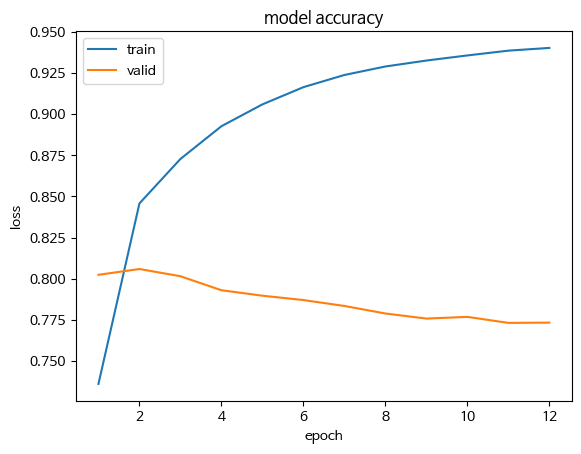

In [ ]:
epochs = range(1, len(history.history['accuracy']) + 1)
plt.plot(epochs, history.history['accuracy'])
plt.plot(epochs, history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'valid'], )
plt.show()

In [ ]:
model.evaluate(x_test_pad, y_test)

1216/1216 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - accuracy: 0.7732 - loss: 1.3229


[1.3049260377883911, 0.7733429074287415]

#   
## 12. 예측해 보기

In [ ]:
print(f'문자열 : {x_test[0]}')
print(f'Sequence : {x_test_pad[0]}')

문자열 : 눈을 사로잡는 독특한 소재 어거지로 놀래키는 공포영화랑은 확연히 달랐다 봉인된 유리문들이 하나하나 열릴때마다 느껴지는 섬뜩함과 짜릿함은 스릴러와 오락성 모두 채워줬다
Sequence : [     0      0      0      0      0      0      0      0      0      0
      0      0      0      0      0      0      0      0      0      0
      0      0      0      0      0      0      0      0    653  17155
    729    676   6618  14330  26891  13900   1740    663 261233  13331
  16048    100]


In [ ]:
# 모델 예측하기(predict)
predict = model.predict(x_test_pad[:1])

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


In [ ]:
predict

array([[3.7485634e-08, 1.0000000e+00]], dtype=float32)

# 배운 내용 정리
1. 네이버 영화 리뷰 데이터 읽어오고
2. 데이터 전처리 : 한글, 공백외의 영어, 숫자, 특수문자등 제거
3. keras 토큰나이져 활용하여 토큰화하고 문장을 숫자로 나열(texts_tp_sequences)
4. 일정 크기의 문장으로 맞추기 위해 패딩수행(pad_sequences)
4. embedding 레이어를 이용해서 단어를 n차원 밀집벡터를 만들고 train시에 학습되도록 했숩니다.
5. LSTM 언어 모델을 활용하여 감성분류 수행
9. 추가로 고민할 사항입니다.
  - embedding 레이어의 출력값 조정하면 ?
  - LSTM 모델 대신에 Bidirectional LSTM 사용하면?
  - Keras Tokenizer+padding 완료된 데이터를 머신러닝으로 학습하면?


<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>

# C. BERT 이용하여 Classification하기
+ 네이버 영화 리뷰 데이터를 가지고
+ BERT 모델학습하여 감정 분류 보겠습니다.

<br>
<br>

#   
## 1. 라이브러리 임포트

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import urllib.request

#   
## 2. 파일 읽어오기

In [ ]:
# 네이버 영화 리뷰 데이터 읽어오기
# urllib.request.urlretrieve("https://raw.githubusercontent.com/e9t/nsmc/master/ratings_train.txt", filename="ratings_train.txt")
# urllib.request.urlretrieve("https://raw.githubusercontent.com/e9t/nsmc/master/ratings_test.txt", filename="ratings_test.txt")

!git clone https://github.com/e9t/nsmc.git

fatal: destination path 'nsmc' already exists and is not an empty directory.


In [ ]:
# 데이터 확인하기
final_data = pd.read_csv("./nsmc/ratings.txt", delimiter='\t', quoting=3)

In [ ]:
final_data.head(3)

,id,document,label
0,8112052,어릴때보고 지금다시봐도 재밌어요ㅋㅋ,1
1,8132799,"디자인을 배우는 학생으로, 외국디자이너와 그들이 일군 전통을 통해 발전해가는 문화산...",1
2,4655635,폴리스스토리 시리즈는 1부터 뉴까지 버릴께 하나도 없음.. 최고.,1


In [ ]:
# 총 200000 건
final_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   id        200000 non-null  int64 
 1   document  199992 non-null  object
 2   label     200000 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 4.6+ MB


#   
## 3. 전처리 : Null, 중복 제거

In [ ]:
# final_data 어떤 컬럼과 내용으로 되어 있는지 다시 확인
final_data.tail()

,id,document,label
199995,8963373,포켓 몬스터 짜가 ㅡㅡ;;,0
199996,3302770,쓰.레.기,0
199997,5458175,완전 사이코영화. 마지막은 더욱더 이 영화의질을 떨어트린다.,0
199998,6908648,왜난 재미없었지 ㅠㅠ 라따뚜이 보고나서 스머프 봐서 그런가 ㅋㅋ,0
199999,8548411,포풍저그가나가신다영차영차영차,0


In [ ]:
# '문장' 컬럼의 내용을 양끝의 빈공간 삭제
final_data['document'] = final_data['document'].str.strip()

In [ ]:
# Null 있는지 확인 : 없음
final_data.isnull().sum()

,0
id,0
document,8
label,0


In [ ]:
# null 데이터 삭제
final_data.dropna(inplace=True)

In [ ]:
# 중복 데이터 있는지 확인 : 중복 존재 확인
final_data['document'].duplicated().sum()

5449

In [ ]:
# 중복 데이터 제거
final_data.drop_duplicates(subset=['document'], inplace=True)

In [ ]:
# info 정보 확인
final_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 194543 entries, 0 to 199999
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   id        194543 non-null  int64 
 1   document  194543 non-null  object
 2   label     194543 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 5.9+ MB


#    
## 4. Okt 라이브러리를 활용한 토큰화

In [ ]:
# 일부 데이터만 불러오기
# Colab의 경우에도 해당 데이터를 처리하기 어렵고 오래 걸리기 때문에 임의로 2만 개의 데이터만 설정합니다.

final_data = pd.concat([final_data.iloc[:10000], final_data.iloc[-10000:]])

In [ ]:
final_data.shape

(20000, 3)

In [ ]:
# 2만건 데이터를 okt 토크나이즈 하는데 2~3분 소요됨.
# okt.morphs() : 텍스트를 형태소 단위 나누고, stem=True : 각 단어에서 어간을 추출

!pip install konlpy

from konlpy.tag import Okt
okt = Okt()
final_data['document'] = final_data['document'].map(lambda x: ' '.join(okt.morphs(x, stem = True)))

In [ ]:
final_data.head(3)

,id,document,label
0,8112052,어리다 때 보고 지금 다시 보다 재밌다 ㅋㅋ,1
1,8132799,"디자인 을 배우다 학생 으로 , 외국 디자이너 와 그 들 이 일군 전통 을 통해 발...",1
2,4655635,폴리스스토리 시리즈 는 1 부터 뉴 까지 버리다 하나 도 없다 .. 최고 .,1


#   
## 5. 훈련-테스트 데이터 분할


In [ ]:
from sklearn.model_selection import train_test_split

train_df, test_df = train_test_split(final_data, test_size=0.2, random_state=42)

train_texts = train_df['document'].astype(str).tolist() # 문자열 데이터로 명시 후 리스트 화
train_labels = train_df['label'].tolist()
test_texts = test_df['document'].astype(str).tolist()
test_labels = test_df['label'].tolist()

#   
## 6. BERT 토크나이저 불러오기

In [ ]:
# !pip install transformers

from transformers import BertTokenizer, BertForSequenceClassification

model_name = 'monologg/kobert'
tokenizer = BertTokenizer.from_pretrained(model_name)

train_encodings = tokenizer(train_texts, truncation=True, padding=True)
test_encodings = tokenizer(test_texts, truncation=True, padding=True)

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'KoBertTokenizer'. 
The class this function is called from is 'BertTokenizer'.


#   
## 7. DataLoader 구성

In [ ]:
# PyTorch에서 제공하는 DataLoader를 활용하여 훈련 데이터를 섞고(Shuffle) 배치(Batch) 단위로 불러올 수 있습니다.

import torch
from torch.utils.data import DataLoader, Dataset

class CustomDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = labels

    def __getitem__(self, idx):
        item = {key: torch.tensor(val[idx]) for key, val in self.encodings.items()}
        item['labels'] = torch.tensor(self.labels[idx])
        return item

    def __len__(self):
        return len(self.labels)

train_dataset = CustomDataset(train_encodings, train_labels)
test_dataset = CustomDataset(test_encodings, test_labels)
batch_size = 64  # 배치 사이즈는 직접 지정해야 합니다.
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)


#   
## 8.BERT 모델 불러오기

In [ ]:
# 0, 1로 분류하기 때문에 레이블은 2개로 지정합니다.
model = BertForSequenceClassification.from_pretrained('monologg/kobert', num_labels=2)

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at monologg/kobert and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


#   
## 9. 모델 훈련

In [ ]:
# 1 epochs 당 5분정도 소요됨. 5 epochs 이면 30분정도 시간 걸림.

from tqdm.auto import tqdm

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')  # GPU 사용이 가능한 경우 설정

start = time.time()

num_epochs = 5
learning_rate = 2e-5 #2e-5는 0.00002
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
criterion = torch.nn.CrossEntropyLoss()
model.to(device) # GPU 사용이 가능한 경우

for epoch in range(num_epochs):
    model.train() # 훈련 모드 지정
    total_loss = 0

    for batch in tqdm(train_loader):
        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['labels'].to(device)

        optimizer.zero_grad()
        outputs = model(input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        total_loss += loss.item()

        loss.backward()
        optimizer.step()

    average_loss = total_loss / len(train_loader)
    print(f"Epoch {epoch+1}/{num_epochs} - Average Loss: {average_loss:.4f}")


print(f'총학습시간: { end - start }')

  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 1/5 - Average Loss: 0.6275


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 2/5 - Average Loss: 0.5465


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 3/5 - Average Loss: 0.4964


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 4/5 - Average Loss: 0.4355


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 5/5 - Average Loss: 0.3706
총학습시간: -1872.4941058158875


#   
## 10. 모델 테스트

In [ ]:
# 71% 성능 보임

model.eval()
correct_predictions = 0
total_predictions = 0

with torch.no_grad():
    for batch in test_loader:
        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['labels'].to(device)

        outputs = model(input_ids, attention_mask=attention_mask)
        _, predicted_labels = torch.max(outputs.logits, dim=1)

        correct_predictions += torch.sum(predicted_labels == labels).item()
        total_predictions += labels.size(0)

accuracy = correct_predictions / total_predictions
print(f"Test Accuracy: {accuracy:.4f}")

Test Accuracy: 0.7147


#   
### 11. 추론


In [ ]:
input_text = '이 영화 진짜 재밌다'
input_encoding = tokenizer.encode_plus(
    input_text,
    truncation=True,
    padding=True,
    return_tensors='pt'
)

input_ids = input_encoding['input_ids'].to(device)
attention_mask = input_encoding['attention_mask'].to(device)

model.eval()
with torch.no_grad():
    outputs = model(input_ids, attention_mask=attention_mask)
    _, predicted_labels = torch.max(outputs.logits, dim=1)
predicted_labels = predicted_labels.item()

print(predicted_labels)


1


<br>
<br>
<br>
<br>

# 배운 내용 정리
1. 네이버 영화 리뷰 데이터 읽어오고
2. 결측치 전처리하고
3. OKT 토큰나이져 활용하여 토큰화
4. 학습시 너무 오래 걸려서 일부 데이터만 사용하여
6. BERT 토크나이저 활용 및 monologg/kobert BERT 모델 사용하여 학습수행
7. BERT 모델을 사용해서 성능이 좋게 나올수 있으나,
8. 네이버 영화 리뷰 데이터 일부를 가지고 학습시 60%정도의 성능이 나왔으며
9. BERT 모델시 학습시간이 많이 걸릴수 있으므로 시간 안배 중요!!
9. 추가로 고민할 사항입니다.
  - 데이터도 줄이고 BERT 모델 학습하는데 30분정도 소요되는데, 시험에서 학습 시간 가능할까?
  - 1만건 아래의 데이터면 시험 시간내에 BERT 모델로 학습 가능할까?
  - 가볍고 한글로 된 활용가능한 BERT 모델은 있는가?
  - 위의 okt 토큰나이저 안하고 할 경우?
  - BERT 모델 학습하는데 시간을 줄일수 있을까?
  - BERT 모델 성능이 정말 나온는가?
